# Data collection

In [2]:
# Imports 

import requests
import zipfile
import os
import pandas as pd
import ftplib
import os
from getpass import getpass
import xarray as xr
import numpy as np

## STEP 1: Collect data

AIS and CMEMS data for the model on:

* 01.01.2020
* 01.04.2020
* 01.07.2020
* 01.10.2020

CMEMS data for the routing on:
* 01.06.2021
* 02.06.2021
* 03.06.2021

### Model data - AIS

In [ ]:
# Download data

# Set file path
urls = ['https://coast.noaa.gov/htdata/CMSP/AISDataHandler/2020/AIS_2020_01_01.zip',
'https://coast.noaa.gov/htdata/CMSP/AISDataHandler/2020/AIS_2020_04_01.zip',
'https://coast.noaa.gov/htdata/CMSP/AISDataHandler/2020/AIS_2020_07_01.zip',
'https://coast.noaa.gov/htdata/CMSP/AISDataHandler/2020/AIS_2020_10_01.zip']

# Unzip data
for url in urls:

  r = requests.get(url)
  filename = url.split('/')[-1]
  with open(filename,'wb') as output_file:
      output_file.write(r.content)
  print(filename)

  try:
      with zipfile.ZipFile(filename) as z:
          z.extractall()
          print("Extracted file")
          os.remove(filename)
  except:
      print("Invalid file")

print("Download completed!")

In [ ]:
# Read csv and create df
ais_data = pd.DataFrame()

for url in urls:

  filename = url.split('/')[-1]
  filename = filename.replace("zip", "csv")
  data = pd.read_csv('data/' + filename)
  ais_data = ais_data.append(data)
  
print("Before preprocessing...")
ais_data = ais_data.reset_index(drop = True)
ais_data

In [ ]:
# Save AIS data to file
ais_data.to_csv('data/ais_data_all.csv')

### Model data - CMEMS
Downloading the data for the 4 days. [DATASETS](https://resources.marine.copernicus.eu/?option=com_csw&task=results)

In [2]:
# Connect to CMEMS FTP

name = 'avilanovacortez'
pwd = 'CMEMS-data-2021'
"""
name = getpass('Enter name: ')
pwd = getpass('Enter pwd: ')
"""

def make_con(url):

    con = ftplib.FTP(url)
    print(con.getwelcome())

    return con

con = make_con('nrt.cmems-du.eu')

220 Welcome to CMEMS FTP service


In [3]:
# Print available data

wav_url = '/Core/GLOBAL_ANALYSIS_FORECAST_WAV_001_027/global-analysis-forecast-wav-001-027/2020/' # 3-hourly
phy_url = '/Core/GLOBAL_ANALYSIS_FORECAST_PHY_001_024/global-analysis-forecast-phy-001-024/2020/' # 24-hourly

def print_collection(url, con):

  try:

    con.login(name, pwd)
    # Navigate to a wave forecast product
    con.cwd(url)
    # Retrieve as list
    con.retrlines('LIST') 
    
  except ftplib.all_errors as e:
    print('FTP error:', e)

#print_collection(wav_url + '07', con) # Print content for July

In [4]:
# Download data 

wav_url = '/Core/GLOBAL_ANALYSIS_FORECAST_WAV_001_027/global-analysis-forecast-wav-001-027/2020/' # 3-hourly
phy_url = '/Core/GLOBAL_ANALYSIS_FORECAST_PHY_001_024/global-analysis-forecast-phy-001-024/2020/' # 24-hourly

wav_jan = "mfwamglocep_2020010100_R20200102.nc"
wav_apr = "mfwamglocep_2020040100_R20200402.nc"
wav_jul = "mfwamglocep_2020070100_R20200702.nc"
wav_oct = "mfwamglocep_2020100100_R20201002.nc"

phy_jan = "mercatorpsy4v3r1_gl12_mean_20200101_R20200115.nc"
phy_apr = "mercatorpsy4v3r1_gl12_mean_20200401_R20200415.nc"
phy_jul = "mercatorpsy4v3r1_gl12_mean_20200701_R20200715.nc"
phy_oct = "mercatorpsy4v3r1_gl12_mean_20201001_R20201014.nc"

def download_ftp(url, prod_name):
  # Check if file exists, taken from source at the top
  if os.path.isfile(prod_name):
    print("There is already a local copy of {}".format(prod_name))

  else:
    try:

      con.login(name, pwd)
      con.cwd(url)

      with open(prod_name, 'wb') as fp:
        con.retrbinary('RETR {}'.format(prod_name), fp.write)
            
    except ftplib.all_errors as e:
      print('FTP error:', e)

"""
# Use this to download data 
download_ftp(wav_url + '01', wav_jan)
download_ftp(wav_url + '04', wav_apr)
download_ftp(wav_url + '07', wav_jul)
download_ftp(wav_url + '10', wav_oct)

download_ftp(phy_url + '01', phy_jan)
download_ftp(phy_url + '04', phy_apr)
download_ftp(phy_url + '07', phy_jul)
download_ftp(phy_url + '10', phy_oct)
"""

"\n# Use this to download data \ndownload_ftp(wav_url + '01', wav_jan)\ndownload_ftp(wav_url + '04', wav_apr)\ndownload_ftp(wav_url + '07', wav_jul)\ndownload_ftp(wav_url + '10', wav_oct)\n\ndownload_ftp(phy_url + '01', phy_jan)\ndownload_ftp(phy_url + '04', phy_apr)\ndownload_ftp(phy_url + '07', phy_jul)\ndownload_ftp(phy_url + '10', phy_oct)\n"

In [ ]:
"""
# OPTIONAL: Reduce CMEMS waves data size by using bbox

# Between Rio de Janeiro and Lisboa
# bbox = ((-9, 22), (-46, 38))

def get_closest(array, value):
    return np.abs(array - value).argmin()
    
ds_wav_jan = xr.open_dataset('data/' + wav_jan)
ds_wav_apr = xr.open_dataset('data/' + wav_apr)
ds_wav_jul = xr.open_dataset('data/' + wav_jul)
ds_wav_oct = xr.open_dataset('data/' + wav_oct)

ds_wav_all = [ds_wav_jan, ds_wav_apr, ds_wav_jul, ds_wav_oct]

datasets_wav = []

for ds_month in ds_wav_all:
  
  lon_min = get_closest(ds_month.longitude.data, bbox[0][0])
  lon_max = get_closest(ds_month.longitude.data, bbox[1][0])
  lat_min = get_closest(ds_month.latitude.data, bbox[0][1])
  lat_max = get_closest(ds_month.latitude.data, bbox[1][1])

  ds_wav_month_reg = ds_month.isel(time = 0, longitude = slice(lon_min, lon_max), latitude = slice(lat_min, lat_max))
  datasets_wav.append(ds_wav_month_reg)

ds_wav = xr.concat(datasets_wav, dim = 'time')
ds_wav
"""

In [ ]:
"""
# OPTIONAL: Reduce CMEMS physics data size by using bbox

ds_phy_jan = xr.open_dataset('data/' + phy_jan)
ds_phy_apr = xr.open_dataset('data/' + phy_apr)
ds_phy_jul = xr.open_dataset('data/' + phy_jul)
ds_phy_oct = xr.open_dataset('data/' + phy_oct)

ds_phy_all = [ds_phy_jan, ds_phy_apr, ds_phy_jul, ds_phy_oct]

datasets_phy = []

for ds_month in ds_phy_all:
  
  lon_min = get_closest(ds_month.longitude.data, bbox[0][0])
  lon_max = get_closest(ds_month.longitude.data, bbox[1][0])
  lat_min = get_closest(ds_month.latitude.data, bbox[0][1])
  lat_max = get_closest(ds_month.latitude.data, bbox[1][1])

  ds_phy_month_reg = ds_month.isel(time = 0, longitude = slice(lon_min, lon_max), latitude = slice(lat_min, lat_max))
  datasets_phy.append(ds_phy_month_reg)

ds_phy = xr.concat(datasets_phy, dim = 'time')
ds_phy
"""

In [2]:
# Join all wave products by using open_mfdataset, chunking data in response to memory issues
ds_wav_all = xr.open_mfdataset('data/mfwamglocep*.nc')
ds_wav_all

<xarray.Dataset>
Dimensions:    (latitude: 2041, longitude: 4320, time: 32)
Coordinates:
  * longitude  (longitude) float64 -180.0 -179.9 -179.8 ... 179.8 179.8 179.9
  * latitude   (latitude) float64 -80.0 -79.92 -79.83 ... 89.83 89.92 90.0
  * time       (time) datetime64[ns] 2020-01-01T03:00:00 ... 2020-10-02
Data variables: (12/17)
    VHM0       (time, latitude, longitude) float32 dask.array<chunksize=(8, 2041, 4320), meta=np.ndarray>
    VMDR_WW    (time, latitude, longitude) float32 dask.array<chunksize=(8, 2041, 4320), meta=np.ndarray>
    VHM0_WW    (time, latitude, longitude) float32 dask.array<chunksize=(8, 2041, 4320), meta=np.ndarray>
    VMDR_SW1   (time, latitude, longitude) float32 dask.array<chunksize=(8, 2041, 4320), meta=np.ndarray>
    VTM01_SW1  (time, latitude, longitude) float32 dask.array<chunksize=(8, 2041, 4320), meta=np.ndarray>
    VMDR_SW2   (time, latitude, longitude) float32 dask.array<chunksize=(8, 2041, 4320), meta=np.ndarray>
    ...         ...
    VTPK       (time, latitude, longitude) float32 dask.array<chunksize=(8, 2041, 4320), meta=np.ndarray>
    VSDX       (time, latitude, longitude) float32 dask.array<chunksize=(8, 2041, 4320), meta=np.ndarray>
    VSDY       (time, latitude, longitude) float32 dask.array<chunksize=(8, 2041, 4320), meta=np.ndarray>
    VPED       (time, latitude, longitude) float32 dask.array<chunksize=(8, 2041, 4320), meta=np.ndarray>
    VTM02      (time, latitude, longitude) float32 dask.array<chunksize=(8, 2041, 4320), meta=np.ndarray>
    VTM01_WW   (time, latitude, longitude) float32 dask.array<chunksize=(8, 2041, 4320), meta=np.ndarray>
Attributes: (12/27)
    Conventions:                   CF-1.6
    time_coverage_start:           20200101-03:00:00
    time_coverage_end:             20200102-00:00:00
    date_created:                  20200102-06:22:00
    product_type:                  hindcast
    product:                       GLOBAL_ANALYSIS_FORECAST_WAV_001_027
    ...                            ...
    geospatial_lon_step:           0.08332825
    geospatial_lon_units:          degree
    geospatial_lat_min:            -80.0
    geospatial_lat_max:            90.0
    geospatial_lat_step:           0.08333588
    geospatial_lat_units:          degree

In [3]:
ds_phy_all = xr.open_mfdataset('data/mercator*.nc')
ds_phy_all

<xarray.Dataset>
Dimensions:    (depth: 50, latitude: 2041, longitude: 4320, time: 4)
Coordinates:
  * longitude  (longitude) float32 -180.0 -179.9 -179.8 ... 179.8 179.8 179.9
  * latitude   (latitude) float32 -80.0 -79.92 -79.83 ... 89.83 89.92 90.0
  * depth      (depth) float32 0.494 1.541 2.646 ... 5.275e+03 5.728e+03
  * time       (time) datetime64[ns] 2020-01-01T12:00:00 ... 2020-10-01T12:00:00
Data variables:
    mlotst     (time, latitude, longitude) float32 dask.array<chunksize=(1, 2041, 4320), meta=np.ndarray>
    zos        (time, latitude, longitude) float32 dask.array<chunksize=(1, 2041, 4320), meta=np.ndarray>
    bottomT    (time, latitude, longitude) float32 dask.array<chunksize=(1, 2041, 4320), meta=np.ndarray>
    sithick    (time, latitude, longitude) float32 dask.array<chunksize=(1, 2041, 4320), meta=np.ndarray>
    siconc     (time, latitude, longitude) float32 dask.array<chunksize=(1, 2041, 4320), meta=np.ndarray>
    usi        (time, latitude, longitude) float32 dask.array<chunksize=(1, 2041, 4320), meta=np.ndarray>
    vsi        (time, latitude, longitude) float32 dask.array<chunksize=(1, 2041, 4320), meta=np.ndarray>
    thetao     (time, depth, latitude, longitude) float32 dask.array<chunksize=(1, 50, 2041, 4320), meta=np.ndarray>
    so         (time, depth, latitude, longitude) float32 dask.array<chunksize=(1, 50, 2041, 4320), meta=np.ndarray>
    uo         (time, depth, latitude, longitude) float32 dask.array<chunksize=(1, 50, 2041, 4320), meta=np.ndarray>
    vo         (time, depth, latitude, longitude) float32 dask.array<chunksize=(1, 50, 2041, 4320), meta=np.ndarray>
Attributes: (12/24)
    title:              daily mean fields from Global Ocean Physics Analysis ...
    easting:            longitude
    northing:           latitude
    history:            2020/01/12 21:22:06 MERCATOR OCEAN Netcdf creation
    source:             MERCATOR PSY4V3R1
    institution:        MERCATOR OCEAN
    ...                 ...
    longitude_min:      -180.0
    longitude_max:      179.91667
    latitude_min:       -80.0
    latitude_max:       90.0
    z_min:              0.494025
    z_max:              5727.917

### Routing data - CMEMS

In [5]:
# Print available data
wav_url = '/Core/GLOBAL_ANALYSIS_FORECAST_WAV_001_027/global-analysis-forecast-wav-001-027/2021/' 
phy_url = '/Core/GLOBAL_ANALYSIS_FORECAST_PHY_001_024/global-analysis-forecast-phy-001-024/2021/' 

def print_collection(url, con):

  try:
   
    con.login(name, pwd)
    con.cwd(url)
    con.retrlines('LIST') 
    
  except ftplib.all_errors as e:
    print('FTP error:', e)

print_collection(wav_url + '06', con)

-rw-rw-r--    1 ftp      ftp      628809933 Jun 02 06:43 mfwamglocep_2021060100_R20210602.nc
-rw-rw-r--    1 ftp      ftp      627424635 Jun 03 06:43 mfwamglocep_2021060200_R20210603.nc
-rw-rw-r--    1 ftp      ftp      626650929 Jun 04 06:44 mfwamglocep_2021060300_R20210604.nc
-rw-rw-r--    1 ftp      ftp      627215789 Jun 05 06:44 mfwamglocep_2021060400_R20210605.nc
-rw-rw-r--    1 ftp      ftp      628465468 Jun 06 06:43 mfwamglocep_2021060500_R20210606.nc
-rw-rw-r--    1 ftp      ftp      631917858 Jun 07 06:43 mfwamglocep_2021060600_R20210607.nc
-rw-rw-r--    1 ftp      ftp      631770826 Jun 08 06:43 mfwamglocep_2021060700_R20210608.nc
-rw-rw-r--    1 ftp      ftp      628749662 Jun 09 07:17 mfwamglocep_2021060800_R20210609.nc
-rw-rw-r--    1 ftp      ftp      627391670 Jun 10 07:14 mfwamglocep_2021060900_R20210610.nc
-rw-rw-r--    1 ftp      ftp      631807221 Jun 11 06:43 mfwamglocep_2021061000_R20210611.nc
-rw-rw-r--    1 ftp      ftp      635885013 Jun 12 06:43 mfwamglocep_2

In [6]:
wav_2021_06_01 = "mfwamglocep_2021060100_R20210602.nc"
wav_2021_06_02 = "mfwamglocep_2021060200_R20210603.nc"
wav_2021_06_03 = "mfwamglocep_2021060300_R20210604.nc"

phy_2021_06_01 = "mercatorpsy4v3r1_gl12_mean_20210601_R20210609.nc"
phy_2021_06_02 = "mercatorpsy4v3r1_gl12_mean_20210602_R20210616.nc"
phy_2021_06_03 = "mercatorpsy4v3r1_gl12_mean_20210603_R20210616.nc"

download_ftp(wav_url + '06', wav_2021_06_01)
download_ftp(wav_url + '06', wav_2021_06_02)
download_ftp(wav_url + '06', wav_2021_06_03)

download_ftp(phy_url + '06', phy_2021_06_01)
download_ftp(phy_url + '06', phy_2021_06_02)
download_ftp(phy_url + '06', phy_2021_06_03)

In [3]:
ds_phy_all_2021 = xr.open_mfdataset('data/routing/mercator*.nc')
ds_phy_all_2021

<xarray.Dataset>
Dimensions:    (depth: 50, latitude: 2041, longitude: 4320, time: 3)
Coordinates:
  * longitude  (longitude) float32 -180.0 -179.9 -179.8 ... 179.8 179.8 179.9
  * latitude   (latitude) float32 -80.0 -79.92 -79.83 ... 89.83 89.92 90.0
  * depth      (depth) float32 0.494 1.541 2.646 ... 5.275e+03 5.728e+03
  * time       (time) datetime64[ns] 2021-06-01T12:00:00 ... 2021-06-03T12:00:00
Data variables:
    mlotst     (time, latitude, longitude) float32 dask.array<chunksize=(1, 2041, 4320), meta=np.ndarray>
    zos        (time, latitude, longitude) float32 dask.array<chunksize=(1, 2041, 4320), meta=np.ndarray>
    bottomT    (time, latitude, longitude) float32 dask.array<chunksize=(1, 2041, 4320), meta=np.ndarray>
    sithick    (time, latitude, longitude) float32 dask.array<chunksize=(1, 2041, 4320), meta=np.ndarray>
    siconc     (time, latitude, longitude) float32 dask.array<chunksize=(1, 2041, 4320), meta=np.ndarray>
    usi        (time, latitude, longitude) float32 dask.array<chunksize=(1, 2041, 4320), meta=np.ndarray>
    vsi        (time, latitude, longitude) float32 dask.array<chunksize=(1, 2041, 4320), meta=np.ndarray>
    thetao     (time, depth, latitude, longitude) float32 dask.array<chunksize=(1, 50, 2041, 4320), meta=np.ndarray>
    so         (time, depth, latitude, longitude) float32 dask.array<chunksize=(1, 50, 2041, 4320), meta=np.ndarray>
    uo         (time, depth, latitude, longitude) float32 dask.array<chunksize=(1, 50, 2041, 4320), meta=np.ndarray>
    vo         (time, depth, latitude, longitude) float32 dask.array<chunksize=(1, 50, 2041, 4320), meta=np.ndarray>
Attributes: (12/24)
    title:              daily mean fields from Global Ocean Physics Analysis ...
    easting:            longitude
    northing:           latitude
    history:            2021/06/06 19:06:21 MERCATOR OCEAN Netcdf creation
    source:             MERCATOR PSY4V3R1
    institution:        MERCATOR OCEAN
    ...                 ...
    longitude_min:      -180.0
    longitude_max:      179.91667
    latitude_min:       -80.0
    latitude_max:       90.0
    z_min:              0.494025
    z_max:              5727.917

## STEP 2: Merge and preprocess model data
In general:
* Merge AIS data with CMEMS data
* Remove unneccessary columns (show estimated time, latitude, longitude, heading, SOG, COG, Gross Tonage, VHM0, VMDR, Temperature and Salinity)

For CMEMS Data:
* Normalize data and remove its outliers

For AIS Data:
* Remove ships with Status =! 0 or Status =! 8
* Remove ships with SOG < 7 or SOG > 102.2
* Remove ships with latitude > 91 and longitude > 181
* Remove ships with latitude < -91 and longitude < -181
* Remove ships with heading > 361
* WRONG? Calculate Gross Tonnage
* Estimate data base times
* Normalize data (SOG) and remove its outliers

In [4]:
study_data = pd.read_csv('data/ais_data_all.csv')

In [5]:
# Remove ships with status =! 0 and status =! 8
study_data = study_data[(study_data['Status'] == 0) | (study_data['Status'] == 8)].dropna()

# Remove ships with SOG < 5 or SOG > 102.2
study_data = study_data[(study_data['SOG'] > 7) & (study_data['SOG'] < 102.2)].dropna()

# Remove ships with latitude > 91 and longitude > 181
study_data = study_data[(study_data['LAT'] < 91) & (study_data['LAT'] > -91)].dropna()
study_data = study_data[(study_data['LON'] < 181) & (study_data['LON'] > -181)].dropna()

# Remove ships with heading > 361
study_data = study_data[(study_data['Heading'] < 361)].dropna()

# Calculate tonnage (Length * Breadth * Depth * S) - WE DON'T HAVE THE DEPTH
# According to https://cdn.shopify.com/s/files/1/1021/8837/files/Tonnage_Guide_1_-_Simplified_Measurement.pdf?1513
study_data['GrossTonnage'] = 0.67 * study_data['Length'] * study_data['Width']

study_data = study_data.reset_index(drop=True)
study_data

,Unnamed: 0,MMSI,BaseDateTime,LAT,LON,SOG,COG,Heading,VesselName,IMO,CallSign,VesselType,Status,Length,Width,Draft,Cargo,TranscieverClass,GrossTonnage
0,9,477628100,2020-01-01T00:00:01,36.80096,-75.22302,12.8,-128.7,283.0,NINGBO SEAL,IMO9579066,VRJD3,70.0,0.0,225.0,32.0,14.3,70.0,B,4824.00
1,17,538002845,2020-01-01T00:00:10,26.08420,-79.48273,13.2,189.0,187.0,YASA GOLDEN DARDANEL,IMO9339985,V7ME9,80.0,0.0,245.0,42.0,15.0,89.0,B,6894.30
2,50,249974000,2020-01-01T00:00:06,29.34368,-94.74366,10.2,85.7,86.0,PTI RHINE,IMO9313462,9HA4456,80.0,0.0,183.0,32.0,13.2,81.0,B,3923.52
3,55,477542400,2020-01-01T00:00:01,37.76973,-122.35415,10.6,-87.5,326.0,ATLANTIC PISCES,IMO9392781,VRFN3,80.0,0.0,183.0,32.0,12.2,80.0,B,3923.52
4,69,636016431,2020-01-01T00:00:10,26.89363,-79.20262,19.7,154.9,155.0,MSC VAISHNAVI R,IMO9227340,A8RL2,70.0,0.0,282.0,32.0,12.5,71.0,B,6046.08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
720152,30502227,441310000,2020-10-01T23:59:34,26.05327,-79.84955,19.7,4.2,5.0,GLOVIS SOLOMON,IMO9445409,D7GS,70.0,0.0,232.0,32.0,9.4,70.0,B,4974.08
720153,30502254,636013708,2020-10-01T23:58:58,28.44555,-95.59912,12.9,56.0,57.0,NEW ACTIVITY,IMO9361524,A8OU2,80.0,0.0,228.0,42.0,14.8,80.0,B,6415.92
720154,30502305,218092000,2020-10-01T23:59:36,39.18945,-130.91286,19.9,-129.6,280.0,HANOVER EXPRESS,IMO9343716,DFGX2,70.0,0.0,336.0,42.0,14.6,79.0,B,9455.04
720155,30502324,636017617,2020-10-01T23:57:40,17.18697,-67.33857,11.7,110.0,110.0,NORDIC STAVANGER,IMO9514377,D5LX3,70.0,0.0,189.0,32.0,12.7,70.0,B,4052.16


In [6]:
from datetime import datetime, timedelta

# Round the base date time
study_data['BaseDateTime'] = study_data['BaseDateTime'].apply(lambda x: datetime.fromisoformat(x))

def datetime_rounder(time):
    return (time.replace(second = 0, minute = 0, hour = time.hour) + timedelta(hours = time.minute//30))

study_data['EstimatedTime'] = [datetime_rounder(study_data['BaseDateTime'][x]) for x in range(study_data['BaseDateTime'].size)]
study_data['EstimatedTime'] = pd.to_datetime(study_data['EstimatedTime']).dt.strftime('%y-%m-%d %h:%I:%s')
#study_data['EstimatedTime'] = [np.datetime64(study_data['EstimatedTime'][x]) for x in range(study_data['EstimatedTime'].size)]

study_data

,Unnamed: 0,MMSI,BaseDateTime,LAT,LON,SOG,COG,Heading,VesselName,IMO,CallSign,VesselType,Status,Length,Width,Draft,Cargo,TranscieverClass,GrossTonnage,EstimatedTime
0,9,477628100,2020-01-01 00:00:01,36.80096,-75.22302,12.8,-128.7,283.0,NINGBO SEAL,IMO9579066,VRJD3,70.0,0.0,225.0,32.0,14.3,70.0,B,4824.00,2020-01-01 00:00:00
1,17,538002845,2020-01-01 00:00:10,26.08420,-79.48273,13.2,189.0,187.0,YASA GOLDEN DARDANEL,IMO9339985,V7ME9,80.0,0.0,245.0,42.0,15.0,89.0,B,6894.30,2020-01-01 00:00:00
2,50,249974000,2020-01-01 00:00:06,29.34368,-94.74366,10.2,85.7,86.0,PTI RHINE,IMO9313462,9HA4456,80.0,0.0,183.0,32.0,13.2,81.0,B,3923.52,2020-01-01 00:00:00
3,55,477542400,2020-01-01 00:00:01,37.76973,-122.35415,10.6,-87.5,326.0,ATLANTIC PISCES,IMO9392781,VRFN3,80.0,0.0,183.0,32.0,12.2,80.0,B,3923.52,2020-01-01 00:00:00
4,69,636016431,2020-01-01 00:00:10,26.89363,-79.20262,19.7,154.9,155.0,MSC VAISHNAVI R,IMO9227340,A8RL2,70.0,0.0,282.0,32.0,12.5,71.0,B,6046.08,2020-01-01 00:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
720152,30502227,441310000,2020-10-01 23:59:34,26.05327,-79.84955,19.7,4.2,5.0,GLOVIS SOLOMON,IMO9445409,D7GS,70.0,0.0,232.0,32.0,9.4,70.0,B,4974.08,2020-10-02 00:00:00
720153,30502254,636013708,2020-10-01 23:58:58,28.44555,-95.59912,12.9,56.0,57.0,NEW ACTIVITY,IMO9361524,A8OU2,80.0,0.0,228.0,42.0,14.8,80.0,B,6415.92,2020-10-02 00:00:00
720154,30502305,218092000,2020-10-01 23:59:36,39.18945,-130.91286,19.9,-129.6,280.0,HANOVER EXPRESS,IMO9343716,DFGX2,70.0,0.0,336.0,42.0,14.6,79.0,B,9455.04,2020-10-02 00:00:00
720155,30502324,636017617,2020-10-01 23:57:40,17.18697,-67.33857,11.7,110.0,110.0,NORDIC STAVANGER,IMO9514377,D5LX3,70.0,0.0,189.0,32.0,12.7,70.0,B,4052.16,2020-10-02 00:00:00


In [8]:
# Get data for one time
ds_wav = ds_wav_all
ds_phy = ds_phy_all
lat = round(study_data['LAT'].iloc[0])
lon = round(study_data['LON'].iloc[0])
time = str(study_data['EstimatedTime'].iloc[0])

VHM0 = ds_wav.VHM0.sel(time = time, longitude = lon, latitude = lat, method = 'nearest')
VMDR = ds_wav.VMDR.sel(time = time, longitude = lon, latitude = lat, method = 'nearest')
thetao = ds_phy.thetao.sel(time = time, longitude = lon, latitude = lat, depth = 0, method = 'nearest')
salin = ds_phy.so.sel(time = time, longitude = lon, latitude = lat, depth = 0, method = 'nearest')

In [9]:
# Merge AIS and CMEMS data
study_data = study_data.dropna()

study_data['VHM0'] = 0.0
study_data['VMDR'] = 0.0
study_data['Temperature'] = 0.0
study_data['Salinity'] = 0.0

def extract_model():
  
  for index, row in study_data.iterrows():

      lat = round(row['LAT'], 1)
      lon = round(row['LON'], 1)
      time = str(row['EstimatedTime'])

      VHM0 = ds_wav.VHM0.sel(time = time, longitude = lon, latitude = lat, method = 'nearest')
      VMDR = ds_wav.VMDR.sel(time = time, longitude = lon, latitude = lat, method = 'nearest')
      thetao = ds_phy.thetao.sel(time = time, longitude = lon, latitude = lat, depth = 0, method = 'nearest')
      salin = ds_phy.so.sel(time = time, longitude = lon, latitude = lat, depth = 0, method = 'nearest')

      study_data.at[index, 'VHM0'] = VHM0
      study_data.at[index, 'VMDR'] = VMDR
      study_data.at[index, 'Temperature'] = thetao
      study_data.at[index, 'Salinity'] = salin
      
extract_model()

study_data = study_data.dropna()
study_data

2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00


2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00


2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00


2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00


2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00


2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00


2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00


2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00


2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00


2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00


2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00


2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00


2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00


2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00


2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00


2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00


2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00


2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00


2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00


2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00


2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00


2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00


2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00


2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00


2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00


2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00


2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00


2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00


2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 00:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00


2020-01-01 02:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00


2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 00:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 00:00:00
2020-01-01 02:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 00:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 00:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 00:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 00:00:00
2020-01-01 00:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00


2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00


2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 00:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00


2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00


2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00


2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 00:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 00:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 00:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 00:00:00


2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 00:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00


2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00


2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 00:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00


2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00


2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 00:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 00:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00


2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00


2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00


2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00


2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00


2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00


2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00


2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00


2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00


2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00


2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00


2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00


2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00


2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00


2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00


2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00


2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00


2020-01-01 00:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 00:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 01:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 01:00:00
2020-01-01 00:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00


2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 03:00:00
2020-01-01 01:00:00
2020-01-01 04:00:00
2020-01-01 00:00:00
2020-01-01 01:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 01:00:00
2020-01-01 04:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 01:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 01:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00


2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00


2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00


2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00


2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00


2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 01:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 01:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00


2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00


2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 03:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00


2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00


2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 01:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 01:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00


2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00


2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 01:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 01:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 01:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00


2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00


2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 01:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 01:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 01:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 01:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00


2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 01:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 01:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00


2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00


2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 01:00:00
2020-01-01 04:00:00
2020-01-01 01:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 01:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00


2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00


2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00


2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00


2020-01-01 01:00:00
2020-01-01 05:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 01:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 01:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 01:00:00
2020-01-01 05:00:00


2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 01:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00


2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 01:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 01:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 01:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 01:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00


2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00


2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00


2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 01:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00


2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00


2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00


2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00


2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00


2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 01:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 01:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00


2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00


2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00


2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00


2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00


2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00


2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00


2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00


2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00


2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00


2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00


2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 05:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00


2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 05:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00


2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00


2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00


2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00


2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 01:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00


2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00


2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00


2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00


2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00


2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 07:00:00
2020-01-01 01:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 01:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 01:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 01:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 01:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00


2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00


2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00


2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 06:00:00
2020-01-01 07:00:00


2020-01-01 07:00:00
2020-01-01 01:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00


2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00


2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00


2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00


2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00


2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00


2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00


2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 01:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00


2020-01-01 01:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 01:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 01:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 01:00:00
2020-01-01 08:00:00
2020-01-01 01:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00


2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 01:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00


2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00


2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00


2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00


2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00


2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00


2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 01:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 01:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00


2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 07:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00


2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00


2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00


2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00


2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00


2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 01:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 01:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00


2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 01:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 01:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 01:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 01:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00


2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00


2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 01:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00


2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00


2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00


2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00


2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00


2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00


2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 10:00:00
2020-01-01 08:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00


2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00


2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00


2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 01:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 01:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00


2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00


2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00


2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00


2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00


2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 01:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 01:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 01:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00


2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00


2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00


2020-01-01 01:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 01:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00


2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 01:00:00
2020-01-01 10:00:00
2020-01-01 01:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00


2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00


2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 01:00:00
2020-01-01 11:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 01:00:00
2020-01-01 01:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00


2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00


2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 11:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 11:00:00
2020-01-01 09:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 11:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00


2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00


2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00


2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00


2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 02:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 01:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 02:00:00
2020-01-01 01:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 01:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00


2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 02:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00


2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00


2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00


2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00


2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 02:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00


2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00


2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00


2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00


2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 02:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00


2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00


2020-01-01 12:00:00
2020-01-01 02:00:00
2020-01-01 10:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 10:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00


2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00


2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 10:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00


2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 02:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00


2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00


2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00


2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 02:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 02:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 02:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00


2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00


2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00


2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00


2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 02:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 02:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00


2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00


2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00


2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00


2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00


2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00


2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 02:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 02:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00


2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 02:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 02:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00


2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 02:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 02:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00


2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 11:00:00


2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00


2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 02:00:00
2020-01-01 12:00:00
2020-01-01 02:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 02:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 02:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00


2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00


2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00


2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00


2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 02:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00


2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00


2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00


2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00


2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 02:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 02:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00


2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00


2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00


2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00


2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 12:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00


2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 02:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 02:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 02:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 02:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00


2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00


2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00


2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00


2020-01-01 02:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 02:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 02:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 13:00:00


2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 02:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 02:00:00
2020-01-01 13:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 02:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00


2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00


2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 02:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00


2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00


2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00


2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00


2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00


2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 02:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00


2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00


2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 13:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00


2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 13:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00


2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00


2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00


2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00


2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00


2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00


2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00


2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 02:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00


2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00


2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00


2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00


2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00


2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00


2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00


2020-01-01 02:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 02:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 02:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 02:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 02:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 02:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00


2020-01-01 16:00:00
2020-01-01 02:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 14:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 02:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 02:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00


2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 02:00:00
2020-01-01 14:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 02:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 02:00:00
2020-01-01 15:00:00
2020-01-01 02:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 02:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00


2020-01-01 15:00:00
2020-01-01 02:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 02:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 02:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 02:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 02:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00


2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 02:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 02:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 02:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 02:00:00


2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00


2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 02:00:00
2020-01-01 15:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 02:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 02:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00


2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00


2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00


2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00


2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00


2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 02:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00


2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 02:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 02:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00


2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00


2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 02:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 02:00:00
2020-01-01 17:00:00


2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00


2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 16:00:00
2020-01-01 02:00:00
2020-01-01 17:00:00
2020-01-01 02:00:00
2020-01-01 17:00:00
2020-01-01 02:00:00
2020-01-01 02:00:00
2020-01-01 17:00:00
2020-01-01 02:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 02:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 02:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 02:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00


2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00


2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00


2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 03:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 03:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 02:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00


2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00


2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00


2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00


2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 03:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 03:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 03:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00


2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00


2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00


2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00


2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 03:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00


2020-01-01 03:00:00
2020-01-01 17:00:00
2020-01-01 03:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 03:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 03:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 03:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 03:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 03:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 18:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 16:00:00
2020-01-01 03:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 03:00:00


2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 19:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00


2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 19:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 03:00:00
2020-01-01 19:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 03:00:00
2020-01-01 19:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00


2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 16:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 16:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 16:00:00
2020-01-01 17:00:00


2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 03:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00


2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00


2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 03:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 03:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 03:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00


2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00


2020-01-01 03:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 03:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00


2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00


2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00


2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00


2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00


2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 03:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 03:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 03:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 03:00:00
2020-01-01 19:00:00


2020-01-01 03:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 20:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 03:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 03:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00


2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 19:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 03:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00


2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 17:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 17:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00


2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 17:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 17:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00


2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00


2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 03:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 03:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 03:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00


2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00


2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00


2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00


2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00


2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 03:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 03:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00


2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00


2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00


2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00


2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 20:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00


2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 03:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00


2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00


2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00


2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00


2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00


2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 18:00:00
2020-01-01 21:00:00


2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00


2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00


2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 03:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 03:00:00
2020-01-01 21:00:00
2020-01-01 03:00:00
2020-01-01 19:00:00
2020-01-01 03:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 03:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 03:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 03:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00


2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00


2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00


2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 03:00:00
2020-01-01 19:00:00
2020-01-01 03:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 03:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00


2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 03:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00


2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 03:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00


2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00


2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00


2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00


2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 03:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 03:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 03:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00


2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00


2020-01-01 03:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 03:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 03:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00


2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00


2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00


2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00


2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00


2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00


2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00


2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00


2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 03:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00


2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00


2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00


2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00


2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00


2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 20:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00


2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00


2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00


2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00


2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 03:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00


2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00


2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 21:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00


2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 21:00:00
2020-01-01 03:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 03:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 21:00:00


2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 21:00:00


2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 03:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 03:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 03:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 03:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 03:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00


2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-01 03:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00


2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 03:00:00
2020-01-01 03:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00


2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00


2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 03:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 03:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00


2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 21:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00


2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00


2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 04:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 04:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 04:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00


2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 04:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 04:00:00
2020-01-01 22:00:00
2020-01-01 04:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 04:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00


2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 04:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 04:00:00
2020-01-01 22:00:00
2020-01-01 04:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 04:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 04:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00


2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 04:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00


2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 04:00:00
2020-01-01 23:00:00
2020-01-01 04:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 04:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00


2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00


2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 04:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 04:00:00
2020-01-01 23:00:00
2020-01-01 04:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 04:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 04:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00


2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 04:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 04:00:00
2020-01-01 23:00:00
2020-01-01 04:00:00
2020-01-01 23:00:00
2020-01-01 04:00:00
2020-01-01 23:00:00
2020-01-01 04:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00


2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-01 04:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00


2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00


2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00


2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00


2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 04:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 04:00:00
2020-01-01 23:00:00
2020-01-01 04:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00


2020-01-01 04:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 04:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 23:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00


2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-02 00:00:00
2020-01-01 04:00:00
2020-01-02 00:00:00


2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 04:00:00
2020-01-01 04:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00


2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00


2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00
2020-01-01 05:00:00


2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00


2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00
2020-01-01 06:00:00


2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00


2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00
2020-01-01 07:00:00


2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00


2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00
2020-01-01 08:00:00


2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 08:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00


2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00


2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 09:00:00


2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00


2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 10:00:00
2020-01-01 11:00:00


2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00


2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 12:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00
2020-01-01 11:00:00


2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00


2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00
2020-01-01 12:00:00


2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00


2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00
2020-01-01 13:00:00


2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00


2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00
2020-01-01 14:00:00


2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00


2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00
2020-01-01 15:00:00


2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00


2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00
2020-01-01 16:00:00


2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00


2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00
2020-01-01 17:00:00


2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00


2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00
2020-01-01 18:00:00


2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00


2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 19:00:00
2020-01-01 19:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00


2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00


2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 20:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00


2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00
2020-01-01 21:00:00


2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00


2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00
2020-01-01 22:00:00


2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00


2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00
2020-01-01 23:00:00


2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00
2020-01-02 00:00:00


2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00


2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00


2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00


2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00


2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00


2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00


2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00


2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00


2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00


2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 01:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 01:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 00:00:00
2020-04-01 01:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00


2020-04-01 00:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00


2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00


2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00


2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00


2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00


2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00


2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00


2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00


2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00


2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00


2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00


2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00


2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00


2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00


2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00


2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00


2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00


2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00


2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00


2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00


2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00


2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00


2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00


2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00


2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00


2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00


2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00


2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00


2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00


2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00


2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00


2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00


2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00


2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00


2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00


2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00


2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00


2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00


2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00


2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00


2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00


2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00


2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00


2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00


2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00


2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00


2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00


2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00


2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00


2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00


2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00


2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00


2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00


2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00


2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00


2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00


2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00


2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00


2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00


2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00


2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00


2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00


2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00


2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00


2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00


2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00


2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 03:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00


2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00


2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00


2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00


2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00


2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00


2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00


2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00


2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00


2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00


2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00


2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00


2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00


2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00


2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00


2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00


2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00


2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00


2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00


2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00


2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00


2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00


2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00


2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00


2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00


2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00


2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00


2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00


2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00


2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00


2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00


2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00


2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00


2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00


2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00


2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00


2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00


2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 05:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00


2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00


2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00


2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00


2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00


2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00


2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00


2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00


2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00


2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00


2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00


2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00


2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00


2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00


2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00


2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00


2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00


2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00


2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00


2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00


2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00


2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00


2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00


2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00


2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00


2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00


2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 00:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00


2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00


2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00


2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00


2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00


2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00


2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00


2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00


2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00


2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00


2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 07:00:00


2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00


2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00


2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00


2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00


2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00


2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00


2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00


2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00


2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00


2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00


2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00


2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00


2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00


2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00


2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00


2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00


2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00


2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00


2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00


2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00


2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00


2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00


2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00


2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00


2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00


2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00


2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00


2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00


2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00


2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00


2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00


2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00


2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00


2020-04-01 00:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 00:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 00:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 00:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 00:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00


2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00


2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 09:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00


2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00


2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00


2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 00:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00


2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00


2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00


2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00


2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00


2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00


2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00


2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00


2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00


2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00


2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00


2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00


2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00


2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00


2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00


2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00


2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00


2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00


2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00


2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00


2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00


2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00


2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00


2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00


2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00


2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 11:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 11:00:00
2020-04-01 13:00:00


2020-04-01 13:00:00
2020-04-01 11:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 11:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 11:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00


2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00


2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 00:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00


2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00


2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00


2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00


2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00


2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00


2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00


2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00


2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00


2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00


2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 12:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 12:00:00


2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00


2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00


2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00


2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00


2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00


2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00


2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00


2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00


2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00


2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00


2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00


2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00


2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 13:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 13:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 13:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 13:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 13:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00


2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 13:00:00
2020-04-01 15:00:00


2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00


2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00


2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00


2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00


2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00


2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00


2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00


2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00


2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00


2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00


2020-04-01 16:00:00
2020-04-01 14:00:00
2020-04-01 16:00:00
2020-04-01 14:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00


2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 14:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 14:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 14:00:00
2020-04-01 16:00:00


2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 14:00:00
2020-04-01 16:00:00
2020-04-01 14:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 14:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 14:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 14:00:00


2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00


2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00


2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00


2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00


2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 00:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00


2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00


2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00


2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00


2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00


2020-04-01 17:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 17:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00


2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 15:00:00
2020-04-01 17:00:00
2020-04-01 15:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 15:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00


2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 15:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 15:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 15:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 15:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00


2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 15:00:00
2020-04-01 17:00:00
2020-04-01 15:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 15:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 15:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 15:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00


2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00


2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00


2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00


2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00


2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00


2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00


2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00


2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00


2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00


2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 18:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 16:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 16:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00


2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 16:00:00
2020-04-01 18:00:00


2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 16:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 16:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00


2020-04-01 18:00:00
2020-04-01 16:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 16:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 16:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 16:00:00
2020-04-01 18:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 16:00:00
2020-04-01 18:00:00
2020-04-01 16:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00


2020-04-01 18:00:00
2020-04-01 16:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 16:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00


2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00


2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00


2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00


2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00


2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00


2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00


2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00


2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00


2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00


2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00


2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 17:00:00


2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00


2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00


2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00


2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 17:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00


2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00


2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00


2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00


2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00


2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00


2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00


2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00


2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00


2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 18:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00


2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 18:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 20:00:00
2020-04-01 18:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00


2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 18:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 18:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00


2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 20:00:00
2020-04-01 18:00:00
2020-04-01 20:00:00


2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 18:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 18:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 18:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 18:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 18:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00


2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00


2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00


2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00


2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00


2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00


2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00


2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00


2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00


2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00


2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00


2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00


2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00


2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00


2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00


2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 19:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00


2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00


2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00


2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00


2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00


2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00


2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00


2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00


2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 00:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 22:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00


2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00


2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 20:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00


2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 20:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 20:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00


2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00


2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 20:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 20:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 20:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00


2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 20:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 20:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 20:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 20:00:00
2020-04-01 22:00:00
2020-04-01 20:00:00
2020-04-01 22:00:00
2020-04-01 20:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 20:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00


2020-04-01 20:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 20:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00


2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00


2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00


2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00


2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00


2020-04-01 00:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 00:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 00:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 00:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00


2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00


2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00


2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00


2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00


2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00


2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00


2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00


2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00


2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00


2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 21:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00


2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00


2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00


2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00


2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00


2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00


2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00


2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00


2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00


2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00


2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00


2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00


2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00


2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 22:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 22:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00


2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00


2020-04-01 22:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 22:00:00
2020-04-02 00:00:00
2020-04-01 22:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00


2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 22:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 22:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00


2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 22:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 22:00:00
2020-04-02 00:00:00
2020-04-01 22:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00


2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 22:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00


2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 00:00:00
2020-04-02 00:00:00


2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00


2020-04-01 23:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 23:00:00
2020-04-01 00:00:00
2020-04-01 23:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 23:00:00
2020-04-01 00:00:00
2020-04-01 23:00:00
2020-04-01 00:00:00
2020-04-01 23:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 00:00:00
2020-04-01 23:00:00
2020-04-01 00:00:00
2020-04-01 23:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 23:00:00


2020-04-01 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 01:00:00
2020-04-01 23:00:00
2020-04-01 01:00:00
2020-04-01 23:00:00
2020-04-01 01:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 00:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 01:00:00
2020-04-01 23:00:00
2020-04-01 00:00:00
2020-04-01 00:00:00
2020-04-01 23:00:00
2020-04-01 01:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 01:00:00
2020-04-01 23:00:00
2020-04-01 01:00:00
2020-04-01 23:00:00
2020-04-01 00:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 01:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 01:00:00


2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 23:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00


2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00


2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00


2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00


2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 01:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00


2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00


2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00
2020-04-01 02:00:00


2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 02:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00


2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00


2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00
2020-04-01 03:00:00


2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00


2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00


2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 04:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00


2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00


2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00
2020-04-01 05:00:00


2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00


2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00


2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 06:00:00
2020-04-01 06:00:00


2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00


2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00
2020-04-01 07:00:00


2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00


2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00


2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 08:00:00
2020-04-01 09:00:00


2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00


2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00
2020-04-01 09:00:00


2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00


2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00


2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 10:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00


2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00


2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 11:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00


2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00
2020-04-01 12:00:00


2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00


2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00
2020-04-01 13:00:00


2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00


2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00
2020-04-01 14:00:00


2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00
2020-04-01 15:00:00


2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 15:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00


2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00
2020-04-01 16:00:00


2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00


2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00
2020-04-01 17:00:00


2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00


2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00
2020-04-01 18:00:00


2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00


2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00
2020-04-01 19:00:00


2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00


2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00
2020-04-01 20:00:00


2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00


2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00
2020-04-01 21:00:00


2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 21:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00


2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00


2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 23:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00
2020-04-01 22:00:00


2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00


2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00
2020-04-01 23:00:00


2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00
2020-04-02 00:00:00


2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-02 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00


2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00


2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00


2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00


2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00


2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00


2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00


2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00


2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00


2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00


2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00


2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00


2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00


2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00


2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00


2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00


2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00


2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00


2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00


2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00


2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00


2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00


2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 00:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 00:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00


2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 00:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00


2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00


2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 00:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 00:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 00:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 00:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 00:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00


2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00


2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00


2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00


2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00


2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00


2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 20:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00


2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00


2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00


2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 00:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 00:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 00:00:00
2020-07-01 02:00:00
2020-07-01 00:00:00
2020-07-01 00:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00


2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00


2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 00:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00


2020-07-01 00:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 00:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 00:00:00
2020-07-01 02:00:00
2020-07-01 00:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 00:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 00:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00


2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 00:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 00:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 00:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00


2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 00:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00


2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00


2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 00:00:00
2020-07-01 03:00:00
2020-07-01 00:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 20:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00


2020-07-01 00:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00


2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 00:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00


2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 00:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 00:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 00:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 00:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 00:00:00


2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00


2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00


2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00


2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 00:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00


2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00


2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00


2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00


2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00


2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00


2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00


2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00


2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00


2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 02:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00


2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00


2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00


2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00


2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00


2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00


2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00


2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00


2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00


2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00


2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00


2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00


2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00


2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00


2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00


2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00


2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 01:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00


2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 01:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00


2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 02:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00
2020-07-01 01:00:00


2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00


2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00


2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00


2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00


2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 02:00:00


2020-07-01 05:00:00
2020-07-01 02:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 02:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 02:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00


2020-07-01 02:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 02:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00


2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 02:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 02:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00


2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00


2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 02:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 02:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 02:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00


2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 02:00:00
2020-07-01 05:00:00
2020-07-01 02:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00


2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00


2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 02:00:00
2020-07-01 05:00:00


2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 02:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 02:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00


2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00


2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00


2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00


2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00


2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00


2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 04:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00


2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00


2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 02:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 02:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 02:00:00
2020-07-01 05:00:00
2020-07-01 02:00:00
2020-07-01 05:00:00


2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00


2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00


2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 02:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 02:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00


2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00


2020-07-01 02:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 02:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00


2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00


2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00


2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 02:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00


2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 06:00:00
2020-07-01 02:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00


2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00


2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00


2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00


2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00


2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00


2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00


2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00


2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00


2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00


2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00


2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 02:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 02:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 07:00:00
2020-07-01 02:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 02:00:00
2020-07-01 05:00:00
2020-07-01 02:00:00
2020-07-01 07:00:00


2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00


2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00


2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00


2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00


2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 05:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00


2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00


2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00


2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00


2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00


2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00


2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00


2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00


2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00


2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 02:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 02:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 02:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00


2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00


2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 08:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 08:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 08:00:00
2020-07-01 07:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 07:00:00
2020-07-01 08:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 08:00:00
2020-07-01 07:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 08:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00


2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 02:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 07:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 02:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00


2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00


2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00


2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00


2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00


2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00


2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00


2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 02:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00


2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 02:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 02:00:00
2020-07-01 02:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 02:00:00
2020-07-01 08:00:00
2020-07-01 02:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00


2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 02:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 02:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00


2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00


2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00


2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 02:00:00
2020-07-01 08:00:00


2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00


2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 02:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00


2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00


2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00


2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 06:00:00
2020-07-01 09:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 08:00:00
2020-07-01 09:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 09:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 09:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 06:00:00
2020-07-01 09:00:00
2020-07-01 06:00:00
2020-07-01 08:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 06:00:00
2020-07-01 09:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 09:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 09:00:00
2020-07-01 08:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00


2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00


2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00


2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00


2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00


2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00


2020-07-01 09:00:00
2020-07-01 03:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00


2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00


2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00


2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00


2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 03:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 03:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00


2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 03:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00


2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00


2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00


2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00


2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00


2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00


2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 03:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00


2020-07-01 07:00:00
2020-07-01 03:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 09:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 09:00:00
2020-07-01 10:00:00
2020-07-01 03:00:00
2020-07-01 09:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 09:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00


2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00


2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00


2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00


2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00


2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00


2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 03:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00


2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00


2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 03:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00


2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00


2020-07-01 03:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 03:00:00
2020-07-01 10:00:00
2020-07-01 07:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00


2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00


2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00


2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 03:00:00


2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00


2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 03:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00


2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 11:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00


2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 11:00:00
2020-07-01 10:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 11:00:00
2020-07-01 10:00:00
2020-07-01 11:00:00
2020-07-01 10:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 11:00:00
2020-07-01 10:00:00
2020-07-01 11:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 03:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00


2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 03:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 03:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 03:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00


2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00


2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00


2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00


2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00


2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 03:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 03:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 03:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00


2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00


2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 03:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00


2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00


2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00


2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00


2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00


2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 03:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00


2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 03:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00


2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 03:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 03:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00


2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00


2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 08:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00


2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 12:00:00
2020-07-01 11:00:00
2020-07-01 12:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 11:00:00
2020-07-01 12:00:00
2020-07-01 11:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 11:00:00
2020-07-01 12:00:00
2020-07-01 11:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 08:00:00
2020-07-01 12:00:00
2020-07-01 11:00:00
2020-07-01 12:00:00
2020-07-01 11:00:00
2020-07-01 12:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 12:00:00
2020-07-01 11:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 12:00:00
2020-07-01 11:00:00


2020-07-01 11:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 11:00:00
2020-07-01 12:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 11:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 11:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 11:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00


2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00


2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 03:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 03:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 03:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 03:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00


2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00


2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 03:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00


2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 03:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00


2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00


2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00


2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 03:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 03:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 03:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 03:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00


2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00


2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 03:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 03:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 03:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 03:00:00
2020-07-01 12:00:00
2020-07-01 03:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00


2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00


2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00


2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00


2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00


2020-07-01 12:00:00
2020-07-01 13:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 13:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 13:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00


2020-07-01 12:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 12:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 12:00:00
2020-07-01 13:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 13:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 12:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 13:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00


2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 12:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 12:00:00
2020-07-01 13:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 12:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00
2020-07-01 13:00:00
2020-07-01 12:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 12:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 12:00:00


2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00


2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00


2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 03:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 03:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00


2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 13:00:00
2020-07-01 03:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00


2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 09:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00


2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00


2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00


2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 03:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00


2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 03:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00


2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00


2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 03:00:00


2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00


2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 03:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 03:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 03:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00


2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00


2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00


2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 03:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00


2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 03:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00


2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00


2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00


2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00


2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 03:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 03:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00


2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00


2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00


2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 03:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00


2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00


2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00


2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00


2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 10:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 03:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00


2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 11:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 11:00:00


2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 03:00:00
2020-07-01 11:00:00
2020-07-01 14:00:00
2020-07-01 11:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 11:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00


2020-07-01 14:00:00
2020-07-01 03:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 03:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 03:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 03:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 11:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 03:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 11:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 11:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00


2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 03:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 11:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 11:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 03:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 03:00:00
2020-07-01 14:00:00
2020-07-01 03:00:00
2020-07-01 03:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00


2020-07-01 11:00:00
2020-07-01 14:00:00
2020-07-01 11:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 04:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 11:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 11:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 11:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 11:00:00
2020-07-01 14:00:00
2020-07-01 11:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 11:00:00
2020-07-01 14:00:00
2020-07-01 15:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00


2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 14:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 14:00:00
2020-07-01 11:00:00
2020-07-01 14:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 14:00:00
2020-07-01 15:00:00
2020-07-01 14:00:00
2020-07-01 11:00:00
2020-07-01 14:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 14:00:00
2020-07-01 15:00:00
2020-07-01 14:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 14:00:00
2020-07-01 15:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 15:00:00
2020-07-01 14:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 14:00:00
2020-07-01 15:00:00
2020-07-01 14:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00


2020-07-01 04:00:00
2020-07-01 14:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 14:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 14:00:00
2020-07-01 15:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 15:00:00
2020-07-01 14:00:00
2020-07-01 15:00:00
2020-07-01 14:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 15:00:00
2020-07-01 14:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 14:00:00
2020-07-01 15:00:00
2020-07-01 14:00:00
2020-07-01 15:00:00
2020-07-01 14:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00


2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00


2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 04:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 04:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 04:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 04:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 04:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00


2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00


2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00


2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00


2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00


2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00


2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00


2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 04:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00


2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 04:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 04:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 04:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 04:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 04:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 04:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00


2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 04:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 04:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00


2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00


2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00


2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 16:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 04:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 04:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00


2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 15:00:00
2020-07-01 16:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 16:00:00
2020-07-01 15:00:00
2020-07-01 16:00:00
2020-07-01 15:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 16:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 16:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 11:00:00


2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 16:00:00
2020-07-01 15:00:00
2020-07-01 16:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 15:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 15:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 15:00:00
2020-07-01 04:00:00
2020-07-01 15:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 15:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 11:00:00


2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 11:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 11:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00


2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 11:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 11:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00


2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00


2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00


2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00


2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00


2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00


2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00


2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 04:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00


2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00


2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00


2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00


2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00


2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00


2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00


2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00


2020-07-01 16:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 16:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 16:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 16:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 16:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 16:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00


2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 04:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 04:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00


2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00


2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00


2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00


2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 04:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00


2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00


2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00


2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00


2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 04:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 12:00:00
2020-07-01 17:00:00


2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00


2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00


2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 04:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00


2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00


2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00


2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00


2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00


2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 04:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 18:00:00


2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00


2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00


2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00


2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 04:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00


2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00


2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00


2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00


2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00


2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00


2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 13:00:00


2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 04:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 04:00:00
2020-07-01 13:00:00
2020-07-01 04:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 13:00:00
2020-07-01 04:00:00
2020-07-01 14:00:00


2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00
2020-07-01 04:00:00


2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 05:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 18:00:00
2020-07-01 05:00:00
2020-07-01 18:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 18:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00


2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00


2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00


2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 18:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 18:00:00
2020-07-01 14:00:00
2020-07-01 18:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00


2020-07-01 18:00:00
2020-07-01 05:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 05:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 05:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 05:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 05:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 05:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 05:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 05:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 05:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00


2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 19:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 19:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 05:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 05:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 05:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 05:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 05:00:00


2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 15:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 15:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 15:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 15:00:00
2020-07-01 18:00:00
2020-07-01 15:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00


2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 15:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 15:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 15:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 15:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 15:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00


2020-07-01 18:00:00
2020-07-01 15:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 15:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 15:00:00
2020-07-01 05:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 18:00:00
2020-07-01 15:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 15:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 19:00:00
2020-07-01 18:00:00
2020-07-01 15:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 15:00:00
2020-07-01 18:00:00
2020-07-01 05:00:00
2020-07-01 05:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 15:00:00
2020-07-01 05:00:00
2020-07-01 18:00:00
2020-07-01 19:00:00
2020-07-01 05:00:00
2020-07-01 15:00:00


2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 18:00:00
2020-07-01 15:00:00
2020-07-01 18:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 18:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 18:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00


2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00


2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00


2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 06:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 06:00:00


2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00


2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00


2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 06:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 06:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 06:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 06:00:00
2020-07-01 15:00:00
2020-07-01 06:00:00
2020-07-01 19:00:00
2020-07-01 06:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 06:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00


2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00


2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 06:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00


2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 06:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 06:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 06:00:00
2020-07-01 19:00:00
2020-07-01 06:00:00
2020-07-01 15:00:00
2020-07-01 06:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00


2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 06:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 06:00:00


2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00


2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00


2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00


2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00


2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00


2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 06:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 15:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00


2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 19:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 20:00:00
2020-07-01 06:00:00
2020-07-01 19:00:00
2020-07-01 20:00:00
2020-07-01 06:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 19:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 19:00:00
2020-07-01 20:00:00
2020-07-01 15:00:00
2020-07-01 20:00:00
2020-07-01 19:00:00
2020-07-01 20:00:00
2020-07-01 19:00:00
2020-07-01 20:00:00
2020-07-01 19:00:00
2020-07-01 06:00:00
2020-07-01 19:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 15:00:00
2020-07-01 20:00:00


2020-07-01 20:00:00
2020-07-01 15:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 15:00:00
2020-07-01 20:00:00
2020-07-01 15:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00


2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 15:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 15:00:00
2020-07-01 20:00:00
2020-07-01 15:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 15:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00


2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 15:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 15:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 20:00:00
2020-07-01 15:00:00
2020-07-01 20:00:00
2020-07-01 15:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 15:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00


2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 15:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00


2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00


2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 06:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 06:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 06:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 06:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 06:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 15:00:00
2020-07-01 20:00:00


2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00


2020-07-01 06:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 06:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00


2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00


2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00


2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00


2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 06:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00


2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00


2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 06:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 06:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00


2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00


2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00


2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 06:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 06:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00


2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 21:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 21:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 21:00:00
2020-07-01 20:00:00
2020-07-01 21:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00


2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 20:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00


2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00


2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00


2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 06:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 06:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00


2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00


2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00


2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00


2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 06:00:00
2020-07-01 21:00:00
2020-07-01 06:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 06:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 06:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00


2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00


2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00


2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 06:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 06:00:00
2020-07-01 21:00:00
2020-07-01 06:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00


2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00


2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00


2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00


2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 16:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00


2020-07-01 17:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 17:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 17:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 06:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00


2020-07-01 21:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 21:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 06:00:00
2020-07-01 17:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 17:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 17:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 17:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 06:00:00
2020-07-01 21:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 21:00:00
2020-07-01 17:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00


2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 22:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 22:00:00
2020-07-01 21:00:00
2020-07-01 22:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 22:00:00
2020-07-01 21:00:00
2020-07-01 22:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 22:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00


2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 21:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 21:00:00
2020-07-01 22:00:00
2020-07-01 21:00:00
2020-07-01 22:00:00
2020-07-01 21:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 22:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 21:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 17:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 21:00:00
2020-07-01 22:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00


2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00


2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 06:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 06:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00


2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 06:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 06:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00


2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 06:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 06:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00


2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 06:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 06:00:00
2020-07-01 22:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00


2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 18:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00


2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00


2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00


2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00


2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00


2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 06:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00


2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00


2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00


2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00


2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00


2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00


2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00


2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 23:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 06:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 23:00:00
2020-07-01 06:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 23:00:00
2020-07-01 22:00:00
2020-07-01 23:00:00
2020-07-01 22:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 22:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 23:00:00
2020-07-01 06:00:00
2020-07-01 23:00:00
2020-07-01 06:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 06:00:00


2020-07-01 23:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 22:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 22:00:00
2020-07-01 23:00:00
2020-07-01 22:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 22:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 22:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 22:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 22:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00


2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00


2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 06:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00


2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00


2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00


2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00


2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 06:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00


2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00


2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00


2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-02 00:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00


2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 17:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00


2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00


2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 06:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 06:00:00
2020-07-01 06:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00


2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00


2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 06:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 06:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00


2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00


2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00


2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00


2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00


2020-07-01 23:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-02 00:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-02 00:00:00
2020-07-01 23:00:00
2020-07-01 18:00:00
2020-07-01 23:00:00
2020-07-02 00:00:00
2020-07-01 23:00:00
2020-07-02 00:00:00
2020-07-01 23:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 23:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-02 00:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-02 00:00:00
2020-07-01 23:00:00


2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 06:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 06:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 06:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 06:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00


2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00


2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00


2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00


2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00


2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00


2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00


2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 06:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00


2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 06:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 06:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 06:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 06:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00


2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 18:00:00
2020-07-01 06:00:00
2020-07-01 18:00:00
2020-07-01 07:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 06:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 18:00:00
2020-07-01 07:00:00
2020-07-01 18:00:00
2020-07-01 06:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 06:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 18:00:00
2020-07-01 07:00:00
2020-07-01 18:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-02 00:00:00
2020-07-01 18:00:00
2020-07-01 07:00:00
2020-07-01 18:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00


2020-07-01 18:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 18:00:00
2020-07-01 19:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 07:00:00
2020-07-01 18:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 07:00:00
2020-07-01 18:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 07:00:00
2020-07-01 18:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00


2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00


2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00


2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00


2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 07:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00


2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 19:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 19:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00


2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00


2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00


2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00


2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00


2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 21:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 08:00:00
2020-07-01 21:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 20:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 21:00:00
2020-07-01 08:00:00
2020-07-01 08:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 08:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 08:00:00
2020-07-01 21:00:00
2020-07-01 08:00:00
2020-07-01 21:00:00
2020-07-01 08:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00


2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00


2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00


2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00


2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 09:00:00


2020-07-01 09:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 09:00:00
2020-07-01 22:00:00
2020-07-01 09:00:00
2020-07-01 22:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 09:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 22:00:00
2020-07-01 09:00:00
2020-07-01 22:00:00
2020-07-01 09:00:00
2020-07-01 22:00:00
2020-07-01 09:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 09:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 09:00:00


2020-07-01 09:00:00
2020-07-01 22:00:00
2020-07-01 09:00:00
2020-07-01 22:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 09:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 09:00:00
2020-07-01 09:00:00
2020-07-01 22:00:00
2020-07-01 09:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 09:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 09:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 09:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 09:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 09:00:00
2020-07-01 22:00:00


2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00


2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00


2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 22:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00


2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00


2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00


2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 10:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00


2020-07-01 23:00:00
2020-07-01 11:00:00
2020-07-01 23:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 23:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 23:00:00
2020-07-01 11:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 11:00:00
2020-07-01 23:00:00
2020-07-01 11:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 11:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 11:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00


2020-07-01 23:00:00
2020-07-02 00:00:00
2020-07-01 23:00:00
2020-07-01 11:00:00
2020-07-01 23:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 23:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 23:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00


2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00


2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-01 11:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00


2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00
2020-07-01 11:00:00


2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00


2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00


2020-07-01 13:00:00
2020-07-01 12:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 12:00:00
2020-07-01 12:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 12:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 12:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00


2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00


2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 13:00:00


2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00


2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00
2020-07-01 14:00:00


2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00


2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00


2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 15:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 15:00:00
2020-07-01 16:00:00
2020-07-01 15:00:00
2020-07-01 16:00:00


2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00


2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00
2020-07-01 16:00:00


2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00


2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00


2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 17:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00
2020-07-01 18:00:00
2020-07-01 17:00:00


2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 19:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00


2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00
2020-07-01 18:00:00


2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00


2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00


2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 19:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 19:00:00
2020-07-01 20:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 19:00:00
2020-07-01 20:00:00
2020-07-01 19:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 20:00:00
2020-07-01 19:00:00
2020-07-01 19:00:00
2020-07-01 20:00:00
2020-07-01 19:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00


2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00


2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00


2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 20:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 20:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00


2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00


2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00
2020-07-01 21:00:00


2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00


2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00


2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00
2020-07-01 22:00:00


2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00


2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00


2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-02 00:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-01 23:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-01 23:00:00
2020-07-02 00:00:00
2020-07-01 23:00:00


2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00
2020-07-02 00:00:00


2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00


2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00


2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00


2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 02:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00


2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00


2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 01:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00


2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00


2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 01:00:00
2020-10-01 00:00:00


2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 00:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 00:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 00:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00


2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00


2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00


2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00


2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00


2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00


2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00


2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00


2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00


2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00


2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00


2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00


2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00


2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00


2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00


2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00


2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00


2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00


2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00


2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00


2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00


2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00


2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00


2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00


2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00


2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 00:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00


2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00


2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00


2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 02:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 02:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 02:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 02:00:00
2020-10-01 03:00:00
2020-10-01 02:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00


2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 02:00:00
2020-10-01 03:00:00


2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00


2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00


2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00


2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00


2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00


2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00


2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00


2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00


2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00


2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00


2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00


2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00


2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00


2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 04:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 04:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 04:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 04:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00


2020-10-01 04:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 03:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 04:00:00
2020-10-01 03:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 03:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00


2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00


2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00


2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00


2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00


2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00


2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00


2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 00:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 00:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 00:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 00:00:00
2020-10-01 04:00:00
2020-10-01 00:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00


2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00


2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00


2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00


2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00


2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00


2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00


2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 00:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 05:00:00
2020-10-01 04:00:00
2020-10-01 05:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 00:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 00:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00


2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 05:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 05:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 04:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 04:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 04:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 04:00:00
2020-10-01 05:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00


2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00


2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00


2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00


2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00


2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00


2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00


2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00


2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00


2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00


2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00


2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00


2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00


2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 00:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00


2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00


2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 06:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 06:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 06:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 06:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 06:00:00


2020-10-01 05:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 05:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 05:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 05:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 05:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 06:00:00
2020-10-01 05:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 05:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 05:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 05:00:00
2020-10-01 06:00:00
2020-10-01 05:00:00
2020-10-01 06:00:00
2020-10-01 05:00:00
2020-10-01 06:00:00


2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00


2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 00:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 00:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 00:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00


2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00


2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00


2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00


2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00


2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00


2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00


2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00


2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00


2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00


2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00


2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00


2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00


2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00


2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00


2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00


2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00


2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00


2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00


2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00


2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 00:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 00:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00


2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00


2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00


2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00


2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00


2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00


2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00


2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00


2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00


2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00


2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 07:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00


2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00


2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00


2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00


2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00


2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00


2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00


2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00


2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00


2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00


2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00


2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00


2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00


2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00


2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00


2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 08:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00


2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00


2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00


2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00


2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00


2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00


2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00


2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00


2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00


2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00


2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00


2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00


2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00


2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00


2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00


2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 09:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00


2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00


2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00


2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00


2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00


2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00


2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00


2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00


2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00


2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00


2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00


2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00


2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 00:00:00
2020-10-01 10:00:00
2020-10-01 00:00:00
2020-10-01 10:00:00
2020-10-01 00:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 00:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00


2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00


2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00


2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00


2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00


2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00


2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00


2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00


2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00


2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00


2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00


2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00


2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00


2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00


2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00


2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00


2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00


2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00


2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00


2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00


2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00


2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00


2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00


2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00


2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00


2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00


2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00


2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00


2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00


2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00


2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00


2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00


2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00


2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00


2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00


2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00


2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00


2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00


2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00


2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00


2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00


2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00


2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00


2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 15:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00


2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00


2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00


2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00


2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00


2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00


2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 00:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 00:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00


2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00


2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 13:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00


2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00


2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00


2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00


2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00


2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00


2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00


2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00


2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00


2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00


2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00


2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00


2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00


2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00


2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00


2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00


2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00


2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00


2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00


2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00


2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00


2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00


2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00


2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00


2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00


2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00


2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00


2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00


2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00


2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00


2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00


2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00


2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00


2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00


2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00


2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00


2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00


2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00


2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00


2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00


2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00


2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00


2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00


2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00


2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00


2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00


2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00


2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00


2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00


2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00


2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00


2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00


2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00


2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00


2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00


2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00


2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00


2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00


2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00


2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 00:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00


2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00


2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00


2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00


2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00


2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00


2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00


2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00


2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 00:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 00:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 00:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 00:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00


2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00


2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00


2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00


2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00


2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00


2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00


2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00


2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00


2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00


2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00


2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00


2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00


2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00


2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00


2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00


2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00


2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00


2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00


2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00


2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00


2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00


2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00


2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00


2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00


2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00


2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00


2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00


2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00


2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00


2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 19:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00


2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00


2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00


2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00


2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00


2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00


2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00


2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00


2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00


2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00


2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00


2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00


2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 21:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 21:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 21:00:00
2020-10-01 20:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 21:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00


2020-10-01 20:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 20:00:00
2020-10-01 21:00:00
2020-10-01 20:00:00
2020-10-01 21:00:00
2020-10-01 20:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 20:00:00
2020-10-01 21:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 20:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 20:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 21:00:00
2020-10-01 20:00:00
2020-10-01 21:00:00


2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 20:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 20:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00


2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00


2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00


2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00


2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00


2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00


2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00


2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00


2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00


2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00


2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00


2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00


2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00


2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00


2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00


2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00


2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 21:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00


2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00


2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00


2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00


2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00


2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00


2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00


2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00


2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00


2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00


2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00


2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00


2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 00:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00


2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00


2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00


2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00


2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00


2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00


2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00


2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00


2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00


2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00


2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00


2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00


2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00


2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00


2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00


2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00


2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00


2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00


2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00


2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-01 00:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-01 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-01 00:00:00
2020-10-02 00:00:00
2020-10-01 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00


2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00


2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00


2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00


2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00


2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00


2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 01:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00
2020-10-01 01:00:00
2020-10-01 00:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 00:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 00:00:00
2020-10-01 00:00:00


2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00


2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 01:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00


2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 03:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00


2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00
2020-10-01 02:00:00


2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00


2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00
2020-10-01 03:00:00


2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00


2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00
2020-10-01 04:00:00


2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00


2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00
2020-10-01 05:00:00


2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00


2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00


2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 06:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00


2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00


2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00
2020-10-01 07:00:00


2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00


2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00
2020-10-01 08:00:00


2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00


2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00
2020-10-01 09:00:00


2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00


2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 10:00:00


2020-10-01 10:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 10:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00


2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00


2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 11:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00


2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00


2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 12:00:00
2020-10-01 13:00:00
2020-10-01 12:00:00


2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00


2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00
2020-10-01 13:00:00


2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00


2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00


2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 14:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00


2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00


2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00
2020-10-01 15:00:00


2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00


2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00


2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 16:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00


2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00


2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 17:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00


2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 19:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00


2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00
2020-10-01 18:00:00


2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00


2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00
2020-10-01 19:00:00


2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00


2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00
2020-10-01 20:00:00


2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00


2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00
2020-10-01 21:00:00


2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00


2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00


2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 22:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00


2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00


2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00
2020-10-01 23:00:00


2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00
2020-10-02 00:00:00


,Unnamed: 0,MMSI,BaseDateTime,LAT,LON,SOG,COG,Heading,VesselName,IMO,...,Width,Draft,Cargo,TranscieverClass,GrossTonnage,EstimatedTime,VHM0,VMDR,Temperature,Salinity
0,9,477628100,2020-01-01 00:00:01,36.80096,-75.22302,12.8,-128.7,283.0,NINGBO SEAL,IMO9579066,...,32.0,14.3,70.0,B,4824.00,2020-01-01 00:00:00,1.39,100.310005,11.198431,33.129368
1,17,538002845,2020-01-01 00:00:10,26.08420,-79.48273,13.2,189.0,187.0,YASA GOLDEN DARDANEL,IMO9339985,...,42.0,15.0,89.0,B,6894.30,2020-01-01 00:00:00,0.57,19.089996,26.477219,36.495560
2,50,249974000,2020-01-01 00:00:06,29.34368,-94.74366,10.2,85.7,86.0,PTI RHINE,IMO9313462,...,32.0,13.2,81.0,B,3923.52,2020-01-01 00:00:00,0.12,116.449997,15.011536,29.747917
3,55,477542400,2020-01-01 00:00:01,37.76973,-122.35415,10.6,-87.5,326.0,ATLANTIC PISCES,IMO9392781,...,32.0,12.2,80.0,B,3923.52,2020-01-01 00:00:00,0.54,268.399994,11.247505,24.410231
4,69,636016431,2020-01-01 00:00:10,26.89363,-79.20262,19.7,154.9,155.0,MSC VAISHNAVI R,IMO9227340,...,32.0,12.5,71.0,B,6046.08,2020-01-01 00:00:00,0.59,8.040009,25.577044,36.657307
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
720152,30502227,441310000,2020-10-01 23:59:34,26.05327,-79.84955,19.7,4.2,5.0,GLOVIS SOLOMON,IMO9445409,...,32.0,9.4,70.0,B,4974.08,2020-10-02 00:00:00,0.69,20.380005,30.107212,36.167484
720153,30502254,636013708,2020-10-01 23:58:58,28.44555,-95.59912,12.9,56.0,57.0,NEW ACTIVITY,IMO9361524,...,42.0,14.8,80.0,B,6415.92,2020-10-02 00:00:00,0.24,109.980003,27.348095,31.464582
720154,30502305,218092000,2020-10-01 23:59:36,39.18945,-130.91286,19.9,-129.6,280.0,HANOVER EXPRESS,IMO9343716,...,42.0,14.6,79.0,B,9455.04,2020-10-02 00:00:00,2.59,276.130005,21.117924,32.650227
720155,30502324,636017617,2020-10-01 23:57:40,17.18697,-67.33857,11.7,110.0,110.0,NORDIC STAVANGER,IMO9514377,...,32.0,12.7,70.0,B,4052.16,2020-10-02 00:00:00,2.38,93.130005,29.782005,34.815517


In [10]:
# Save merge data (not fully processed)
study_data.to_csv('data/study_data_np.csv')

In [ ]:
study_data = pd.read_csv('data/study_data_np.csv')

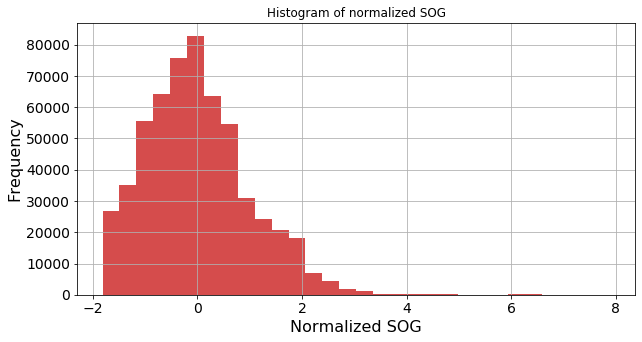

In [11]:
import matplotlib.pyplot as plt

# Normalize SOG
study_data['SOG_norm'] = (study_data['SOG'] - study_data['SOG'].mean(axis = 0)) / study_data['SOG'].std(axis = 0)

# Make histogram of normalized SOG
study_data['SOG_norm'].plot(kind = 'hist', alpha = 0.7, bins = 30, title = 'Histogram of normalized SOG', 
                            grid = True, figsize = (10,5), fontsize = 14, color = ['#C40000'])
plt.xlabel('Normalized SOG', fontsize = 16)
plt.ylabel("Frequency", fontsize = 16)
plt.show()

# Remove SOG outliers
study_data = study_data[(study_data['SOG_norm'] < 4)].dropna()

# Standardize to 0 to 1
study_data['SOG_norm'] = ((study_data['SOG_norm'] - study_data['SOG_norm'].min(axis=0)) / 
                           (study_data['SOG_norm'].max(axis = 0) - study_data['SOG_norm'].min(axis=0)))

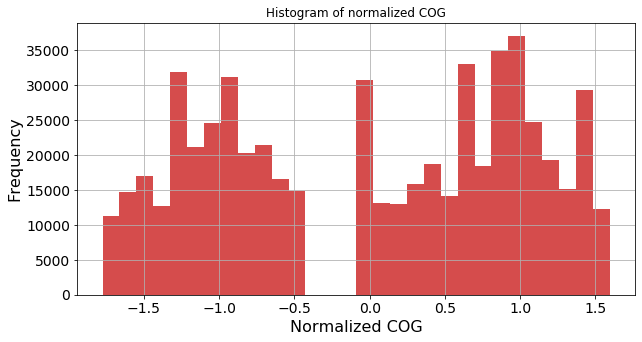

In [12]:
# Normalize COG
study_data['COG_norm'] = (study_data['COG'] - study_data['COG'].mean(axis = 0)) / study_data['COG'].std(axis = 0)

# Make histogram of normalized COG
study_data['COG_norm'].plot(kind = 'hist', alpha = 0.7, bins = 30, title = 'Histogram of normalized COG', 
                            grid = True, figsize = (10,5), fontsize = 14, color = ['#C40000'])
plt.xlabel('Normalized COG', fontsize = 16)
plt.ylabel("Frequency", fontsize = 16)
plt.show()

# Standardize to 0 to 1
study_data['COG_norm'] = ((study_data['COG_norm'] - study_data['COG_norm'].min(axis=0)) / 
                           (study_data['COG_norm'].max(axis = 0) - study_data['COG_norm'].min(axis=0)))

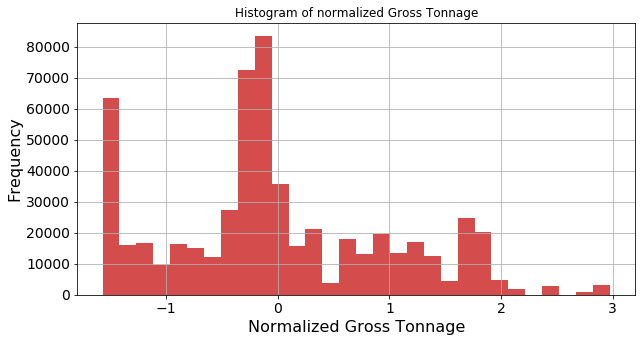

In [13]:
# Normalize Gross Tonnage
study_data['GrossTonnage_norm'] = (study_data['GrossTonnage'] - study_data['GrossTonnage'].mean(axis = 0)) / study_data['GrossTonnage'].std(axis = 0)

# Make histogram of normalized Gross Tonnage
study_data['GrossTonnage_norm'].plot(kind = 'hist', alpha = 0.7, bins = 30, title = 'Histogram of normalized Gross Tonnage', 
                            grid = True, figsize = (10,5), fontsize = 14, color = ['#C40000'])
plt.xlabel('Normalized Gross Tonnage', fontsize = 16)
plt.ylabel("Frequency", fontsize = 16)
plt.show()

# Standardize to 0 to 1
study_data['GrossTonnage_norm'] = ((study_data['GrossTonnage_norm'] - study_data['GrossTonnage_norm'].min(axis=0)) / 
                                    (study_data['GrossTonnage_norm'].max(axis = 0) - study_data['GrossTonnage_norm'].min(axis=0)))

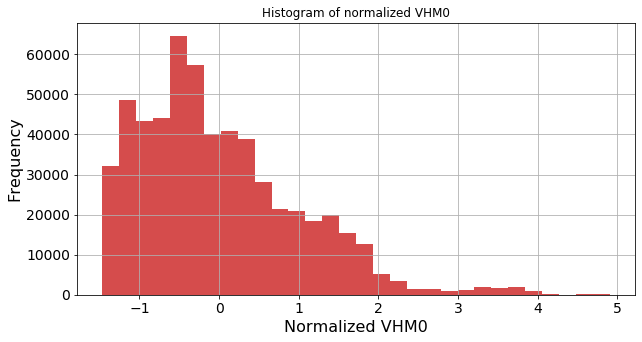

In [14]:
# Normalize VHM0
study_data['VHM0_norm'] = (study_data['VHM0'] - study_data['VHM0'].mean(axis = 0)) / study_data['VHM0'].std(axis = 0)

# Make histogram of normalized VHM0
study_data['VHM0_norm'].plot(kind = 'hist', alpha = 0.7, bins = 30, title = 'Histogram of normalized VHM0', 
                            grid = True, figsize = (10,5), fontsize = 14, color = ['#C40000'])
plt.xlabel('Normalized VHM0', fontsize = 16)
plt.ylabel("Frequency", fontsize = 16)
plt.show()

# Remove VHM0 outliers
study_data = study_data[(study_data['VHM0_norm'] > -2)].dropna()

# Standardize to 0 to 1
study_data['VHM0_norm'] = ((study_data['VHM0_norm'] - study_data['VHM0_norm'].min(axis=0)) / 
                            (study_data['VHM0_norm'].max(axis = 0) - study_data['VHM0_norm'].min(axis=0)))

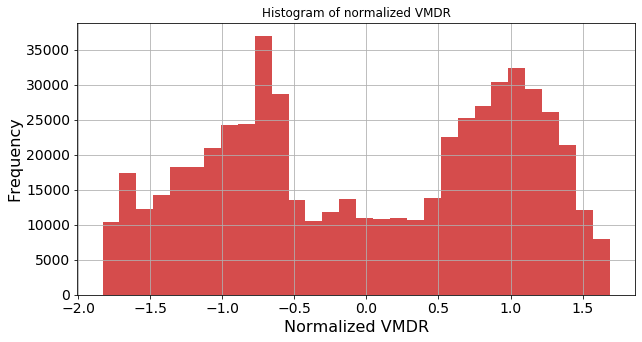

In [15]:
# Normalize VMDR
study_data['VMDR_norm'] = (study_data['VMDR'] - study_data['VMDR'].mean(axis = 0)) / study_data['VMDR'].std(axis = 0)

# Make histogram of normalized VMDR
study_data['VMDR_norm'].plot(kind = 'hist', alpha = 0.7, bins = 30, title = 'Histogram of normalized VMDR', 
                            grid = True, figsize = (10,5), fontsize = 14, color = ['#C40000'])
plt.xlabel('Normalized VMDR', fontsize = 16)
plt.ylabel("Frequency", fontsize = 16)
plt.show()

# Standardize to 0 to 1
study_data['VMDR_norm'] = ((study_data['VMDR_norm'] - study_data['VMDR_norm'].min(axis=0)) / 
                            (study_data['VMDR_norm'].max(axis = 0) - study_data['VMDR_norm'].min(axis=0)))

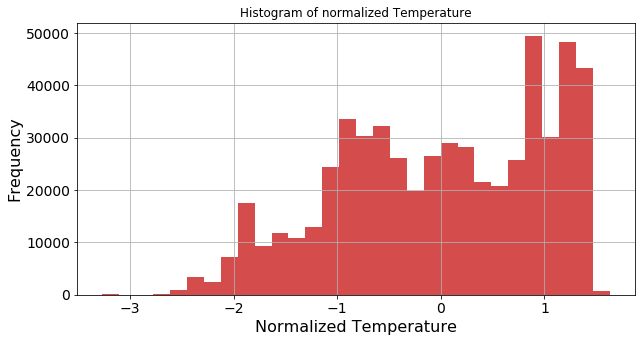

In [16]:
# Normalize Temperature
study_data['Temperature_norm'] = (study_data['Temperature'] - study_data['Temperature'].mean(axis = 0)) / study_data['Temperature'].std(axis = 0)

# Make histogram of normalized Temperature
study_data['Temperature_norm'].plot(kind = 'hist', alpha = 0.7, bins = 30, title = 'Histogram of normalized Temperature', 
                            grid = True, figsize = (10,5), fontsize = 14, color = ['#C40000'])
plt.xlabel('Normalized Temperature', fontsize = 16)
plt.ylabel("Frequency", fontsize = 16)
plt.show()

# Standardize to 0 to 1
study_data['Temperature_norm'] = ((study_data['Temperature_norm'] - study_data['Temperature_norm'].min(axis=0)) / 
                                   (study_data['Temperature_norm'].max(axis = 0) - study_data['Temperature_norm'].min(axis=0)))

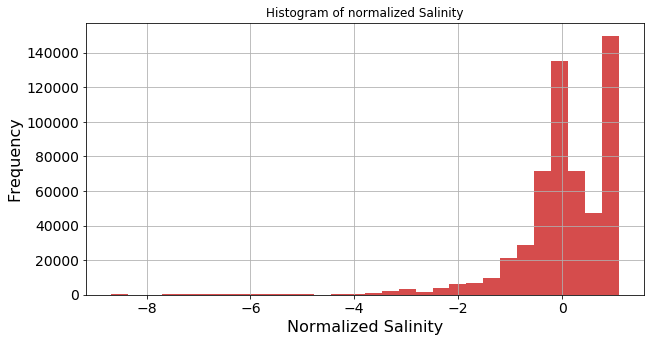

In [17]:
# Normalize Salinity
study_data['Salinity_norm'] = (study_data['Salinity'] - study_data['Salinity'].mean(axis = 0)) / study_data['Salinity'].std(axis = 0)

# Make histogram of normalized Salinity
study_data['Salinity_norm'].plot(kind = 'hist', alpha = 0.7, bins = 30, title = 'Histogram of normalized Salinity', 
                            grid = True, figsize = (10,5), fontsize = 14, color = ['#C40000'])
plt.xlabel('Normalized Salinity', fontsize = 16)
plt.ylabel("Frequency", fontsize = 16)
plt.show()

# Standardize to 0 to 1
study_data['Salinity_norm'] = ((study_data['Salinity_norm'] - study_data['Salinity_norm'].min(axis=0)) / 
                               (study_data['Salinity_norm'].max(axis=0) - study_data['Salinity_norm'].min(axis=0)))

In [19]:
print("After preprocessing...")
final_data = study_data.filter(['EstimatedTime', 'LAT', 'LON', 'Heading', 'SOG_norm', 'COG_norm', 'GrossTonnage_norm', 'VHM0_norm', 'VMDR_norm', 'Temperature_norm', 'Salinity_norm'])
final_data = final_data.dropna()
final_data.to_csv('data/preprocessed_data.csv')
final_data

After preprocessing...


,EstimatedTime,LAT,LON,Heading,SOG_norm,COG_norm,GrossTonnage_norm,VHM0_norm,VMDR_norm,Temperature_norm,Salinity_norm
0,2020-01-01 00:00:00,36.80096,-75.22302,283.0,0.309783,0.185836,0.360360,0.216849,0.278556,0.375870,0.887591
1,2020-01-01 00:00:00,26.08420,-79.48273,187.0,0.331522,0.961661,0.515015,0.088924,0.052832,0.835220,0.982673
2,2020-01-01 00:00:00,29.34368,-94.74366,86.0,0.168478,0.709402,0.293093,0.018721,0.323412,0.490509,0.792078
3,2020-01-01 00:00:00,37.76973,-122.35415,326.0,0.190217,0.286447,0.293093,0.084243,0.745706,0.377345,0.641309
4,2020-01-01 00:00:00,26.89363,-79.20262,155.0,0.684783,0.878388,0.451652,0.092044,0.022122,0.808156,0.987242
...,...,...,...,...,...,...,...,...,...,...,...
720152,2020-10-02 00:00:00,26.05327,-79.84955,5.0,0.684783,0.510379,0.371572,0.107644,0.056417,0.944354,0.973406
720153,2020-10-02 00:00:00,28.44555,-95.59912,57.0,0.315217,0.636874,0.479279,0.037441,0.305431,0.861402,0.840567
720154,2020-10-02 00:00:00,39.18945,-130.91286,280.0,0.695652,0.183639,0.706306,0.404056,0.767189,0.674095,0.874057
720155,2020-10-02 00:00:00,17.18697,-67.33857,110.0,0.250000,0.768742,0.302703,0.371295,0.258602,0.934577,0.935218


## Notes from meetings

**02 - 06 - 2021**

Space time cubes
- 52N: sfTracks space time cube

Simple solution:
- Start simple
- Least cost path as in simple_routing.ipynb

**09 - 06 - 2021**

Easy retrieval for cmems data: harvester.maridata EnvDataAPI github

Regarding modelling:
- Filter by ship types
- 2000 records are too low
- Have specific lengths and widths of ships
- Exclude SOG below 7 knots
- Standardization & normalization are recommended

Regarding routing:
- Genetic algorithm (Group C)
- Multi-objective optimization: pymoo - NSGA-II